# Section 33: Principal Component Analysis 

- 04/28/20

- online-ds-pt-100719

## Questions/Commments/Insights?



-  How to choose a component and feature vector is still not clear.  I understand that the vector with the highest value is the principal component. Still having trouble reading and understanding them…
- Parameters in PCA(). Eg. whiten=True ..any others that are more often used than others?
- And how does this work?
plt.plot(range(1,65), pca.explained_variance_ratio_.cumsum())


## Learning Objectives


- Gain an intuitive understanding of PCA and eigenvalue decomposition.
- Understand how Principal Component Analysis reduces dimensionality.


- **ACTIVITY:**
    - Use all 1100+ features of the [National Health and Nutrition Examination Survey (NHANES)](https://www.kaggle.com/cdc/national-health-and-nutrition-examination-survey) to find clusters of people in 3D space.
    - Build a Pipeline for data processing.
    - Get top 20 principal components.
    - Visualize 3 PC's at a time in 3D.
    

# Principal Component Analysis 

### Videos (Matrix Transformation & Eigenvector):

- Linear Transformations: https://www.youtube.com/watch?v=kYB8IZa5AuE
- Egienvectors: https://www.youtube.com/watch?v=PFDu9oVAE-g

### What is the "curse of dimensionality"?

<img src="https://raw.githubusercontent.com/learn-co-students/dsc-curse-of-dimensionality-online-ds-pt-100719/master/images/sparsity.png">

- [In-Depth Article About the Curse of Dimensionality](https://www.visiondummy.com/2014/04/curse-dimensionality-affect-classification/)



<img src="https://www.visiondummy.com/wp-content/uploads/2014/04/overfitting.png">

### How does PCA solve this?


<img src="https://raw.githubusercontent.com/jirvingphd/dsc-pca-in-scikitlearn-online-ds-sp-000/master/images/inhouse_pca.png">

<img src="https://raw.githubusercontent.com/jirvingphd/dsc-unsupervised-learning-online-ds-pt-100719/master/images/pca.gif">


## Steps for Performing PCA

The theory behind PCA rests upon many foundational concepts of linear algebra. After all, PCA is re-encoding a dataset into an alternative basis (the axes). Here's the exact steps:

1. Recenter each feature of the dataset by subtracting that feature's mean from the feature vector
2. Calculate the covariance matrix for your centered dataset
3. Calculate the eigenvectors of the covariance matrix
    1. You'll further investigate the concept of eigenvectors in the upcoming lesson
4. Project the dataset into the new feature space: Multiply the eigenvectors by the mean centered features

### PCA OVERVIEW

#### Type of Learning
- Unsupervised

#### Assumptions
- Correlation among features

#### Advantages
- Captures most of the variance in a smaller number of features

#### Disadvantages
- Number of principal components that explain most of the variance are determined by the USER

#### Requirements 

- Features must be scaled (StandardScaler)
- Sensitive to missing data.
- Sensitive to outliers.

#### Example Use
- Reducing feature space
- Preprocessing"
- Creating a few, informative variables from tons of data

# ACTIVITY: USING PCA TO FIND 3D CLUSTERS OF PEOPLE

- [Dataset](https://www.kaggle.com/cdc/national-health-and-nutrition-examination-survey)
    
- [Complete variable list](https://wwwn.cdc.gov/Nchs/Nhanes/Search/variablelist.aspx?Component=Demographics&CycleBeginYear=2013)

In [1]:
from fsds_100719.imports import *
import plotly.express as px

from sklearn.preprocessing import StandardScaler,LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

np.random.seed(123)

fsds_1007219  v0.7.21 loaded.  Read the docs: https://fsds.readthedocs.io/en/latest/ 


Handle,Package,Description
dp,IPython.display,Display modules with helpful display and clearing commands.
fs,fsds_100719,Custom data science bootcamp student package
mpl,matplotlib,Matplotlib's base OOP module with formatting artists
plt,matplotlib.pyplot,Matplotlib's matlab-like plotting module
np,numpy,scientific computing with Python
pd,pandas,High performance data structures and tools
sns,seaborn,High-level data visualization library based on matplotlib


[i] Pandas .iplot() method activated.


In [2]:
pd.set_option('display.max_columns',0)
pd.set_option('display.max_info_rows',200)

In [3]:
plt.style.use('seaborn-notebook')

In [4]:
import os, sys

## Instructor Notebook Folderpath:
# folder = '../datasets/national-health-and-nutrition-examination-survey/'

## Study Group Notebook Folderpath
folder = 'datasets/national-health-and-nutrition-examination-survey/'
os.listdir(folder)

['medications.csv',
 'diet.csv',
 'examination.csv',
 'demographic.csv',
 'labs.csv',
 'questionnaire.csv']

In [5]:
## Use glob to get csvs
import glob
files = glob.glob(folder+'*.csv')
files

['datasets/national-health-and-nutrition-examination-survey/medications.csv',
 'datasets/national-health-and-nutrition-examination-survey/diet.csv',
 'datasets/national-health-and-nutrition-examination-survey/examination.csv',
 'datasets/national-health-and-nutrition-examination-survey/demographic.csv',
 'datasets/national-health-and-nutrition-examination-survey/labs.csv',
 'datasets/national-health-and-nutrition-examination-survey/questionnaire.csv']

In [6]:
## Load in all CSVs combined
# pd.read_csv(files[0],encoding='latin-1')
df = pd.concat([pd.read_csv(file) for file in files[1:]],axis=1)
df

,SEQN,WTDRD1,WTDR2D,DR1DRSTZ,DR1EXMER,DRABF,DRDINT,DR1DBIH,DR1DAY,DR1LANG,DR1MNRSP,DR1HELPD,DBQ095Z,DBD100,DRQSPREP,DR1STY,DR1SKY,DRQSDIET,DRQSDT1,DRQSDT2,DRQSDT3,DRQSDT4,DRQSDT5,DRQSDT6,DRQSDT7,DRQSDT8,DRQSDT9,DRQSDT10,DRQSDT11,DRQSDT12,DRQSDT91,DR1TNUMF,DR1TKCAL,DR1TPROT,DR1TCARB,DR1TSUGR,DR1TFIBE,DR1TTFAT,DR1TSFAT,DR1TMFAT,DR1TPFAT,DR1TCHOL,DR1TATOC,DR1TATOA,DR1TRET,DR1TVARA,DR1TACAR,DR1TBCAR,DR1TCRYP,DR1TLYCO,DR1TLZ,DR1TVB1,DR1TVB2,DR1TNIAC,DR1TVB6,DR1TFOLA,DR1TFA,DR1TFF,DR1TFDFE,DR1TCHL,DR1TVB12,DR1TB12A,DR1TVC,DR1TVD,DR1TVK,DR1TCALC,DR1TPHOS,DR1TMAGN,DR1TIRON,DR1TZINC,DR1TCOPP,DR1TSODI,DR1TPOTA,DR1TSELE,DR1TCAFF,DR1TTHEO,DR1TALCO,DR1TMOIS,DR1TS040,DR1TS060,DR1TS080,DR1TS100,DR1TS120,DR1TS140,DR1TS160,DR1TS180,DR1TM161,DR1TM181,DR1TM201,DR1TM221,...,SMQ690F,SMQ830,SMQ840,SMDANY,SMAQUEX.y,SXD021,SXQ800,SXQ803,SXQ806,SXQ809,SXQ700,SXQ703,SXQ706,SXQ709,SXD031,SXD171,SXD510,SXQ824,SXQ827,SXD633,SXQ636,SXQ639,SXD642,SXQ410,SXQ550,SXQ836,SXQ841,SXQ853,SXD621,SXQ624,SXQ627,SXD630,SXQ645,SXQ648,SXQ610,SXQ251,SXQ590,SXQ600,SXD101,SXD450,SXQ724,SXQ727,SXQ130,SXQ490,SXQ741,SXQ753,SXQ260,SXQ265,SXQ267,SXQ270,SXQ272,SXQ280,SXQ292,SXQ294,WHD010,WHD020,WHQ030,WHQ040,WHD050,WHQ060,WHQ070,WHD080A,WHD080B,WHD080C,WHD080D,WHD080E,WHD080F,WHD080G,WHD080H,WHD080I,WHD080J,WHD080K,WHD080M,WHD080N,WHD080O,WHD080P,WHD080Q,WHD080R,WHD080S,WHD080T,WHD080U,WHD080L,WHD110,WHD120,WHD130,WHD140,WHQ150,WHQ030M,WHQ500,WHQ520
0,73557.0,16888.327864,12930.890649,1.0,49.0,2.0,2.0,6.0,2.0,1.0,1.0,13.0,3.0,2.0,4.0,2.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,11.0,1574.0,43.63,239.59,176.47,10.8,52.81,17.819,18.493,8.829,209.0,3.92,0.0,70.0,110.0,60.0,304.0,278.0,1398.0,430.0,1.057,1.216,11.804,0.951,285.0,66.0,219.0,330.0,216.3,2.79,0.00,241.4,3.3,29.2,949.0,756.0,206.0,8.41,8.85,1.072,1323.0,2228.0,62.5,203.0,36.0,0.0,2701.79,0.219,0.099,0.103,0.153,0.346,1.221,9.694,5.408,1.173,16.796,0.121,0.001,...,NaN,NaN,NaN,1.0,2.0,1.0,1.0,1.0,2.0,2.0,NaN,NaN,NaN,NaN,15.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,69.0,180.0,3.0,3.0,210.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.0,270.0,200.0,69.0,270.0,62.0,NaN,NaN,NaN
1,73558.0,17932.143865,12684.148869,1.0,59.0,2.0,2.0,4.0,1.0,1.0,1.0,13.0,1.0,2.0,3.0,1.0,1.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.0,5062.0,338.13,423.78,44.99,16.7,124.29,53.408,35.481,20.505,2584.0,20.94,0.0,1477.0,1488.0,0.0,145.0,12.0,0.0,899.0,4.178,5.168,65.396,4.415,1243.0,601.0,641.0,1662.0,2149.0,21.45,0.00,2.3,15.2,23.4,3193.0,6427.0,903.0,26.88,30.36,4.130,9726.0,4930.0,715.8,240.0,0.0,119.0,6779.99,1.872,1.160,0.802,1.286,1.297,6.516,27.952,12.107,2.208,32.429,0.086,0.000,...,NaN,NaN,NaN,1.0,2.0,1.0,1.0,1.0,1.0,2.0,NaN,NaN,NaN,NaN,14.0,10.0,1.0,10.0,1.0,18.0,5.0,0.0,8036.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,2.0,NaN,2.0,2.0,1.0,1.0,NaN,71.0,200.0,3.0,3.0,160.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,240.0,250.0,72.0,250.0,25.0,NaN,NaN,NaN
2,73559.0,59641.812930,39394.236709,1.0,49.0,2.0,2.0,18.0,6.0,1.0,1.0,13.0,1.0,1.0,2.0,2.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,7.0,NaN,NaN,NaN,NaN,NaN,NaN,27.0,1743.0,64.61,224.39,102.90,9.9,65.97,25.263,20.902,12.953,88.0,8.87,0.0,616.0,655.0,21.0,449.0,35.0,515.0,300.0,1.648,1.747,18.342,1.906,423.0,290.0,133.0,625.0,161.2,3.78,1.42,195.1,4.0,40.4,877.0,1198.0,210.0,17.57,8.98,0.949,2943.0,1694.0,98.3,45.0,71.0,0.0,3766.70,0.358,0.128,0.371,0.455,3.008,2.067,10.691,7.497,0.531,19.910,0.164,0.005,...,NaN,NaN,NaN,2.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,70.0,195.0,3.0,2.0,195.0,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10175 entries, 0 to 10174
Columns: 1816 entries, SEQN to WHQ520
dtypes: float64(1759), int64(26), object(31)
memory usage: 141.0+ MB


In [8]:
## Get a list of categorical columns to encode
cat_cols = df.select_dtypes('O').columns
cat_cols

Index(['OHX02CTC', 'OHX03CTC', 'OHX04CTC', 'OHX05CTC', 'OHX06CTC', 'OHX07CTC',
       'OHX08CTC', 'OHX09CTC', 'OHX10CTC', 'OHX11CTC', 'OHX12CTC', 'OHX13CTC',
       'OHX14CTC', 'OHX15CTC', 'OHX18CTC', 'OHX19CTC', 'OHX20CTC', 'OHX21CTC',
       'OHX22CTC', 'OHX23CTC', 'OHX24CTC', 'OHX25CTC', 'OHX26CTC', 'OHX27CTC',
       'OHX28CTC', 'OHX29CTC', 'OHX30CTC', 'OHX31CTC', 'CSXTSEQ', 'SMDUPCA',
       'SMD100BR'],
      dtype='object')

In [9]:
## Check for null values in cat cols
df[cat_cols].isna().sum()

OHX02CTC    1210
OHX03CTC    1210
OHX04CTC    1210
OHX05CTC    1210
OHX06CTC    1210
OHX07CTC    1210
OHX08CTC    1210
OHX09CTC    1210
OHX10CTC    1210
OHX11CTC    1210
OHX12CTC    1210
OHX13CTC    1210
OHX14CTC    1210
OHX15CTC    1210
OHX18CTC    1210
OHX19CTC    1210
OHX20CTC    1210
OHX21CTC    1210
OHX22CTC    1210
OHX23CTC    1210
OHX24CTC    1210
OHX25CTC    1210
OHX26CTC    1210
OHX27CTC    1210
OHX28CTC    1210
OHX29CTC    1210
OHX30CTC    1210
OHX31CTC    1210
CSXTSEQ     6941
SMDUPCA     9359
SMD100BR    9083
dtype: int64

In [10]:
## Label Encode cat cols
df[cat_cols] = df[cat_cols].fillna('Missing')
df[cat_cols].isna().sum()

OHX02CTC    0
OHX03CTC    0
OHX04CTC    0
OHX05CTC    0
OHX06CTC    0
OHX07CTC    0
OHX08CTC    0
OHX09CTC    0
OHX10CTC    0
OHX11CTC    0
OHX12CTC    0
OHX13CTC    0
OHX14CTC    0
OHX15CTC    0
OHX18CTC    0
OHX19CTC    0
OHX20CTC    0
OHX21CTC    0
OHX22CTC    0
OHX23CTC    0
OHX24CTC    0
OHX25CTC    0
OHX26CTC    0
OHX27CTC    0
OHX28CTC    0
OHX29CTC    0
OHX30CTC    0
OHX31CTC    0
CSXTSEQ     0
SMDUPCA     0
SMD100BR    0
dtype: int64

In [11]:
encoders = {}
for col in cat_cols:
    encoder = LabelEncoder()
    df[col] = encoder.fit_transform(df[col])
    encoders[col] = encoder
df[cat_cols]

,OHX02CTC,OHX03CTC,OHX04CTC,OHX05CTC,OHX06CTC,OHX07CTC,OHX08CTC,OHX09CTC,OHX10CTC,OHX11CTC,OHX12CTC,OHX13CTC,OHX14CTC,OHX15CTC,OHX18CTC,OHX19CTC,OHX20CTC,OHX21CTC,OHX22CTC,OHX23CTC,OHX24CTC,OHX25CTC,OHX26CTC,OHX27CTC,OHX28CTC,OHX29CTC,OHX30CTC,OHX31CTC,CSXTSEQ,SMDUPCA,SMD100BR
0,4,4,6,6,6,6,6,6,6,6,6,6,4,4,4,4,6,6,6,5,5,5,6,6,6,6,4,4,1,208,79
1,11,1,9,9,9,9,9,9,9,9,9,13,10,10,0,0,2,9,9,8,8,8,9,9,13,9,0,0,0,208,79
2,11,12,12,9,9,9,9,14,9,9,9,9,10,10,11,11,14,9,9,12,8,8,9,9,9,13,11,0,0,208,79
3,8,7,0,3,10,9,9,9,9,10,3,0,7,8,8,7,0,3,0,8,8,8,9,10,0,0,7,9,2,208,79
4,0,12,1,14,13,14,8,8,13,13,14,13,10,0,0,0,1,1,9,12,7,13,9,12,1,1,0,0,0,208,79
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10170,3,3,5,5,5,5,5,5,5,5,5,5,3,3,3,3,5,5,5,4,4,4,5,5,5,5,3,3,2,208,79
10171,3,3,5,5,5,5,5,5,5,5,5,5,3,3,3,3,5,5,5,4,4,4,5,5,5,5,3,3,2,208,79
10172,3,3,5,5,5,5,5,5,5,5,5,5,3,3,3,3,5,5,5,4,4,4,5,5,5,5,3,3,2,208,79
10173,3,3,5,5,5,5,5,5,5,5,5,5,3,3,3,3,5,5,5,4,4,4,5,5,5,5,3,3,2,208,79


In [12]:
encoders['OHX20CTC'].inverse_transform(df['OHX20CTC'])

array(['P', 'J', 'Z', ..., 'Missing', 'Missing', 'Missing'], dtype=object)

In [13]:
## Finding the columns with all null values
col_nans = df.isna().sum(axis=0)
col_nans[col_nans==len(df)]

DRQSDT5    10175
BMIHEAD    10175
MCQ240I    10175
MCQ240R    10175
SMQ690J    10175
SMQ861     10175
dtype: int64

In [14]:
drop_me = col_nans[col_nans==len(df)].index

In [15]:
## Drop columns with all null values
df.drop(drop_me,axis=1,inplace=True)

In [16]:
col_nans = df.isna().sum(axis=0)
col_nans[col_nans==len(df)]

Series([], dtype: int64)

### Pipelines

In [17]:
## Lets make a pipeline with SimpleImputer and StandardScaler
from sklearn.pipeline import Pipeline

pipe = Pipeline([
                ('imp',SimpleImputer(strategy='most_frequent')),
                ('sca',StandardScaler())
               ])
pipe

Pipeline(memory=None,
         steps=[('imp',
                 SimpleImputer(add_indicator=False, copy=True, fill_value=None,
                               missing_values=nan, strategy='most_frequent',
                               verbose=0)),
                ('sca',
                 StandardScaler(copy=True, with_mean=True, with_std=True))],
         verbose=False)

In [18]:
## Fit transform df
data = pd.DataFrame( pipe.fit_transform(df),columns=df.columns)
data

,SEQN,WTDRD1,WTDR2D,DR1DRSTZ,DR1EXMER,DRABF,DRDINT,DR1DBIH,DR1DAY,DR1LANG,DR1MNRSP,DR1HELPD,DBQ095Z,DBD100,DRQSPREP,DR1STY,DR1SKY,DRQSDIET,DRQSDT1,DRQSDT2,DRQSDT3,DRQSDT4,DRQSDT6,DRQSDT7,DRQSDT8,DRQSDT9,DRQSDT10,DRQSDT11,DRQSDT12,DRQSDT91,DR1TNUMF,DR1TKCAL,DR1TPROT,DR1TCARB,DR1TSUGR,DR1TFIBE,DR1TTFAT,DR1TSFAT,DR1TMFAT,DR1TPFAT,DR1TCHOL,DR1TATOC,DR1TATOA,DR1TRET,DR1TVARA,DR1TACAR,DR1TBCAR,DR1TCRYP,DR1TLYCO,DR1TLZ,DR1TVB1,DR1TVB2,DR1TNIAC,DR1TVB6,DR1TFOLA,DR1TFA,DR1TFF,DR1TFDFE,DR1TCHL,DR1TVB12,DR1TB12A,DR1TVC,DR1TVD,DR1TVK,DR1TCALC,DR1TPHOS,DR1TMAGN,DR1TIRON,DR1TZINC,DR1TCOPP,DR1TSODI,DR1TPOTA,DR1TSELE,DR1TCAFF,DR1TTHEO,DR1TALCO,DR1TMOIS,DR1TS040,DR1TS060,DR1TS080,DR1TS100,DR1TS120,DR1TS140,DR1TS160,DR1TS180,DR1TM161,DR1TM181,DR1TM201,DR1TM221,DR1TP182,...,SMQ690F,SMQ830,SMQ840,SMDANY,SMAQUEX.y,SXD021,SXQ800,SXQ803,SXQ806,SXQ809,SXQ700,SXQ703,SXQ706,SXQ709,SXD031,SXD171,SXD510,SXQ824,SXQ827,SXD633,SXQ636,SXQ639,SXD642,SXQ410,SXQ550,SXQ836,SXQ841,SXQ853,SXD621,SXQ624,SXQ627,SXD630,SXQ645,SXQ648,SXQ610,SXQ251,SXQ590,SXQ600,SXD101,SXD450,SXQ724,SXQ727,SXQ130,SXQ490,SXQ741,SXQ753,SXQ260,SXQ265,SXQ267,SXQ270,SXQ272,SXQ280,SXQ292,SXQ294,WHD010,WHD020,WHQ030,WHQ040,WHD050,WHQ060,WHQ070,WHD080A,WHD080B,WHD080C,WHD080D,WHD080E,WHD080F,WHD080G,WHD080H,WHD080I,WHD080J,WHD080K,WHD080M,WHD080N,WHD080O,WHD080P,WHD080Q,WHD080R,WHD080S,WHD080T,WHD080U,WHD080L,WHD110,WHD120,WHD130,WHD140,WHQ150,WHQ030M,WHQ500,WHQ520
0,-1.616296,-0.381566,-0.361972,-0.366909,0.234545,0.115522,0.345844,-0.975215,-1.292727,-0.260165,-0.221771,0.355429,-0.020877,0.968468,0.625100,0.151806,-0.043233,0.123882,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.701124,-0.318078,-0.720913,0.129502,1.080395,-0.185234,-0.396777,-0.349738,-0.288571,-0.581555,-0.046779,-0.536715,-0.222951,-0.737233,-0.833343,-0.234392,-0.337223,0.663659,-0.309250,-0.226155,-0.374579,-0.595446,-0.590276,-0.573184,-0.280355,-0.475737,0.398629,-0.392296,-0.380245,-0.309220,-0.350066,2.110961,-0.167889,-0.415085,0.151221,-0.805304,-0.421949,-0.557290,-0.110496,0.036809,-1.078680,-0.031883,-0.590199,0.843136,0.059078,-0.246122,0.328535,-0.373904,-0.516328,-0.251724,-0.513395,-0.351526,-0.517965,-0.398963,0.003617,0.456733,-0.327517,-0.423526,-0.256448,-0.533035,...,0.0,0.03663,-0.034999,-2.493253,0.340117,-0.139445,-0.118373,-0.172911,0.229251,0.048959,-0.08539,-0.203928,0.199627,0.083169,-0.441130,-0.025919,-0.024178,-0.042529,-0.031199,-0.121073,-0.031521,-0.017057,-0.093382,-0.031098,-0.032688,-0.028647,-0.029399,-0.046549,-0.134064,-0.029832,-0.019828,-0.09209,-0.191896,0.240527,-0.042811,0.395123,-0.01709,-0.009936,-0.042224,-0.026246,-0.031697,-0.031267,-0.043289,-0.009927,-0.059587,0.08145,0.05978,0.07058,-0.05971,-0.010446,0.012813,-0.202963,-0.078604,-0.120657,-0.075310,-0.057336,1.493758,1.636701,-0.058942,-0.204412,0.483640,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.006605,-0.111513,-0.089635,0.010341,-0.052234,0.18177,-0.290139,0.129144
1,-1.615967,-0.352487,-0.367031,-0.366909,0.756411,0.115522,0.345844,-1.157019,-1.770376,-0.260165,-0.221771,0.355429,-0.205833,0.968468,-0.256696,-1.371492,-0.043233,0.123882,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.247772,3.443275,6.452045,1.647253,-0.808949,0.358614,1.255309,2.016428,0.741439,0.388343,10.074390,2.008900,-0.222951,2.901475,1.880895,-0.296999,-0.380964,-0.181064,-0.499188,-0.057567,3.194784,2.815740,2.797603,1.711112,3.834568,2.511728,3.262818,3.527751,10.069532,3.868956,-0.350066,-0.772511,2.038503,-0.457461,4.217107,8.153365,4.685801,1.695500,3.308523,4.625025,3.955115,2.353757,9.786467,1.093220,-0.398878,5.487296,3.340133,3.209843,3.071791,0.892028,1.614032,0.451843,2.771748,1.919697,1.769338,1.746014,0.730483,-0.546010,-0.269272,0.156330,...,0.0,0.03663,-0.034999,-2.493253,0.340117,-0.139445,-0.118373,-0.172911,-2.738470,0.048959,-0.08539,-0.203928,0.199627,0.083169,-0.692897,-0.047069,-0.024178,-0.040070,-0.031199,-0.121073,-0.030060,-0.017735,1.979947,-0.031098,-0.032688,-0.0

In [19]:
n_components =20
pipe_pca = Pipeline([
                ('imp',SimpleImputer(strategy='most_frequent')),
                ('sca',StandardScaler()),
                ('pca',PCA(n_components=n_components))
               ])

In [20]:
df.shape

(10175, 1810)

In [21]:
p_components = pipe_pca.fit_transform(df)
p_components.shape

(10175, 20)

In [22]:
p_components

array([[ 2.29746077,  0.78470917,  6.51913661, ..., -0.81437115,
        -0.25937703,  3.10173508],
       [12.84293333,  0.280748  ,  4.77603944, ..., -3.75438891,
        -2.75295258,  8.50989433],
       [ 5.66161446, -0.23556477,  5.22885383, ..., -2.46515755,
        -0.71621357, -3.77762183],
       ...,
       [-5.17444709, -0.97980951, -1.90443517, ..., -0.69401629,
        -1.763373  , -0.95547341],
       [-5.13159108, -0.81324325, -4.85024647, ..., -0.29387325,
        -1.70071224, -0.38148545],
       [-5.04766577, -0.7633199 , -5.91207885, ..., -1.20921399,
        -2.02054629, -0.1560414 ]])

In [23]:
pca = pipe_pca.named_steps['pca']
pca

PCA(copy=True, iterated_power='auto', n_components=20, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [24]:
feature_names = [f"PC{i}" for i in range(1,n_components+1)]
feature_names

['PC1',
 'PC2',
 'PC3',
 'PC4',
 'PC5',
 'PC6',
 'PC7',
 'PC8',
 'PC9',
 'PC10',
 'PC11',
 'PC12',
 'PC13',
 'PC14',
 'PC15',
 'PC16',
 'PC17',
 'PC18',
 'PC19',
 'PC20']

In [25]:
## Get principle components
explained_var = pd.Series(pca.explained_variance_ratio_, index= feature_names)
explained_var

PC1     0.027215
PC2     0.025789
PC3     0.018172
PC4     0.017201
PC5     0.014435
PC6     0.010067
PC7     0.009029
PC8     0.008403
PC9     0.007828
PC10    0.007596
PC11    0.007003
PC12    0.006480
PC13    0.005107
PC14    0.004907
PC15    0.004852
PC16    0.004716
PC17    0.004490
PC18    0.004307
PC19    0.004016
PC20    0.003848
dtype: float64

In [26]:
explained_var.sum()

0.195461974912298

In [27]:
## Make column names for componentns
principal_components = pd.DataFrame(p_components,columns=feature_names)
principal_components

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20
0,2.297461,0.784709,6.519137,-1.803865,-8.992134,9.918041,-0.371696,0.585478,-2.385428,0.051646,-5.633724,-0.304541,-0.722370,3.090669,-0.940355,-1.625393,-1.083446,-0.814371,-0.259377,3.101735
1,12.842933,0.280748,4.776039,-3.864670,13.056878,10.481288,0.650929,-4.756395,5.659493,-1.764409,-0.918743,-0.771414,-0.967715,-2.274111,-0.947974,-0.060995,-3.084467,-3.754389,-2.752953,8.509894
2,5.661614,-0.235565,5.228854,-0.985875,-2.112116,-0.569433,-0.329861,-0.883489,-5.666763,1.276361,3.171977,-0.368773,-0.089931,0.634218,-2.026471,-0.881066,-3.339798,-2.465158,-0.716214,-3.777622
3,-4.781299,-2.679513,-5.138484,0.383098,2.095880,-1.682098,-4.954056,0.521395,-1.125575,0.044283,-5.107066,4.073891,-1.261650,-2.328348,-0.273820,-0.558055,0.019805,2.492608,1.689327,0.184309
4,3.336982,0.265175,8.980402,-1.876171,-5.471719,4.965529,-0.257709,1.915041,-4.403981,-0.467412,-2.877408,5.009110,-1.662599,-0.540405,-2.322693,-0.267124,1.729361,-2.205694,-2.586733,-1.866821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10170,-5.173449,-1.013162,-1.820136,0.136904,-3.265273,0.035865,1.936001,-3.362897,-1.620436,1.090188,-1.179756,-3.299785,-3.118922,1.466554,2.677945,0.583078,-0.534359,-0.939496,-1.719372,-0.330864
10171,-5.077426,-0.866681,-4.372346,0.096089,-3.360055,0.084923,1.116179,1.316229,-1.857714,1.224067,-0.909920,-3.457338,-3.174191,-2.152254,0.189570,-3.179327,-0.777185,0.236522,-1.984388,-0.197463
10172,-5.174447,-0.979810,-1.904435,0.109302,-3.266263,0.026076,1.365228,-1.402517,-2.632297,1.133600,-1.127969,-3.365389,-2.853896,-0.476877,0.262187,-0.204551,-0.453210,-0.694016,-1.763373,-0.955473
10173,-5.131591,-0.813243,-4.850246,0.143402,-3.418877,-0.031899,1.104916,2.442838,-0.047301,0.936722,-0.918536,-3.424529,-2.987313,-1.062535,-0.454746,-1.798453,-0.812733,-0.293873,-1.700712,-0.381485


[Text(0, 0.5, 'PC'), Text(0.5, 0, 'Explained Variance')]

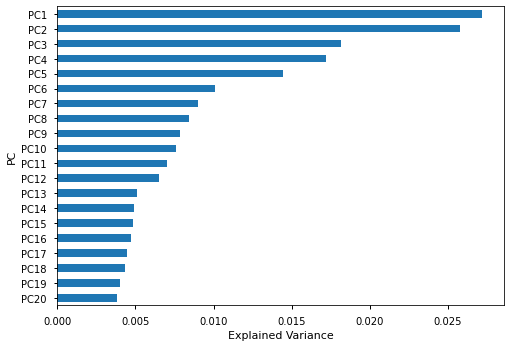

In [28]:
## Plot explained variance
ax = explained_var.sort_values().plot(kind='barh')
ax.set(xlabel='Explained Variance', ylabel='PC')

In [29]:
## Check how much variance is explained by all of our PC's

[Text(0, 0.5, 'PC2'), Text(0.5, 0, 'PCA1')]

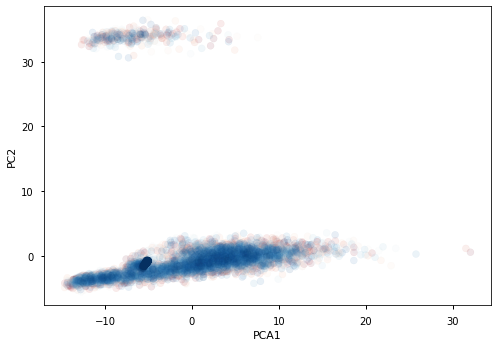

In [30]:
# ## Visualize PC1 vs PC2
c=sns.color_palette('RdBu', n_colors=len(principal_components))
fig,ax = plt.subplots()
ax.scatter(principal_components['PC1'],principal_components['PC2'],alpha=0.1,
           c=c)
ax.set(xlabel='PCA1',ylabel='PC2')

In [31]:
## Make interactive function to show any comparison
from ipywidgets import interact 

@interact(xcol=feature_names,ycol=feature_names)
def plot_pca_2d(xcol='PC1',ycol='PC2'):
    fig, ax = plt.subplots(figsize=(8,6))
    ax.scatter(principal_components[xcol],principal_components[ycol],alpha=0.1,
                c=sns.color_palette('RdBu', n_colors=len(principal_components)))
    ax.set_xlabel(xcol)
    ax.set_ylabel(ycol)

interactive(children=(Dropdown(description='xcol', options=('PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', '…

In [32]:
@interact(xcol=feature_names,ycol=feature_names,zcol=feature_names)
def plot_pca_3d(xcol='PC1',ycol='PC2',zcol='PC3'):
    fig = px.scatter_3d(principal_components,x=xcol,y=ycol,z=zcol)
    fig.update_traces(marker={'size':2})
    return fig

interactive(children=(Dropdown(description='xcol', options=('PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', '…

## TO BE CONTINUED FOR K-MEANS CLUSTERING